In [1]:
import geopandas as gpd
import pandas as pd
from plotly import express as px
import statsmodels.api as sm

from data.constants import WEB_CRS

In [2]:
tract_file_in = "../data/raw/tracts.geojson"

point_panel_in = "../data/final/point_panel.parquet"
line_panel_in = "../data/final/line_panel.parquet"
tract_panel_in = "../data/final/tract_panel.parquet"

# Pipeline in

In [3]:
tracts = gpd.read_file(tract_file_in)

point_panel = pd.read_parquet(point_panel_in)
line_panel = pd.read_parquet(line_panel_in)
tract_panel = pd.read_parquet(tract_panel_in)

In [4]:
point_panel_wkd = point_panel[~point_panel['weekend'].astype(bool)]
line_panel_wkd = line_panel[~line_panel['weekend'].astype(bool)]
tract_panel_wkd = tract_panel[~tract_panel['weekend'].astype(bool)]

# Validate

In [5]:
def count_ids(df):
    return df.groupby(['id','transit']).size().count()

In [6]:
def plot_avg_completion(df):
    n_ids = count_ids(df)
    plot_data = df.groupby('date',sort=True).apply(count_ids, include_groups=False) / n_ids
    return px.line(x=plot_data.index, y=plot_data, title="panel completion")

In [7]:
def plot_transit_completion(df):
    n_ids = df.groupby('transit')[['transit','id']].apply(count_ids)
    plot_data = (df
             .groupby(['date','transit'],sort=True)
             [['transit','id']]
             .apply(count_ids)
             .rename('count')
             .reset_index()
             .assign(pct = lambda x: x['count'] / x['transit'].map(n_ids)))
    return px.line(plot_data, x='date', y='pct', color='transit',title="panel completion")

In [8]:
def completion_matrix(df,rows,cols):
    df = df.assign(exists=1).groupby([rows,cols])['exists'].any().astype(float)
    return df.reset_index().pivot(index=rows, columns=cols, values='exists').fillna(0)

def completion_long(df, rows, cols):
    mat = completion_matrix(df, rows, cols)
    return mat.reset_index().melt(id_vars=rows, var_name=cols, value_name='exists')

In [9]:
plot_transit_completion(point_panel)

In [10]:
plot_transit_completion(line_panel)

In [11]:
plot_transit_completion(tract_panel)

# Validate weekday data

In [12]:
plot_transit_completion(point_panel_wkd)

In [13]:
plot_transit_completion(line_panel_wkd)

In [14]:
plot_transit_completion(tract_panel_wkd)

# Predict drop-out

In [15]:
def minmax_scale(x):
    return (x - x.min()) / (x.max() - x.min())

def model_completion_data(df):
    model_data = completion_long(df, 'date','id')
    model_data['missing'] = 1 - model_data['exists']
    model_data['datenum'] = pd.to_datetime(model_data['date'],'coerce').apply(lambda x: x.timestamp())
    model_data['datenum'] = model_data['datenum'].pipe(minmax_scale)
    spacelike = df[['id','transit','lat','long']].drop_duplicates()
    spacelike['spacerides'] = spacelike['id'].map(df.groupby('id')['rides'].mean())
    timelike = df[['date','weekend']].drop_duplicates()
    timelike['timerides'] = timelike['date'].map(df.groupby('date')['rides'].mean())
    spacetimelike = df[['date','id','rides']].drop_duplicates()
    model_data = model_data.merge(spacelike, how='left')
    model_data = model_data.merge(timelike, how='left')
    model_data = model_data.merge(spacetimelike, how='left')
    model_data['rides'] = model_data['rides'].fillna(0)+1
    return model_data

def model_completion(df, formula=None):
    model_data = model_completion_data(df)
    default_formula = "missing ~ transit + weekend + lat + long + I(lat*long) + I(lat**2) + I(long**2)"
    formula = default_formula if formula is None else formula
    return sm.Logit.from_formula(formula, model_data).fit()

def coefplot(model):
    from statsmodels.graphics.dotplots import dot_plot
    import matplotlib.pyplot as plt
    model_stats = pd.concat([model.conf_int().rename(columns={0:'left',1:'right'}), model.params.rename('mean')], axis=1)
    model_stats['left'] = model_stats['left'] - model_stats['mean']
    model_stats['right'] = model_stats['right'] - model_stats['mean']
    fig = dot_plot(model.params, model_stats[['left','right']], fmt_left_name=model.model.exog_names.__getitem__);
    plt.axvline(0, linestyle='dashed')
    return fig

In [16]:
point_missing = model_completion_data(point_panel)
fig = px.scatter_matrix(point_missing, dimensions=['missing','datenum','lat','long'])
fig.update_traces(diagonal_visible=False)
# The point panel is okay.

In [17]:
line_missing = model_completion_data(line_panel)
fig = px.scatter_matrix(line_missing, dimensions=['missing','datenum','lat','long'])
fig.update_traces(diagonal_visible=False)
# The line panel is sort of ok.

In [18]:
tract_missing = model_completion_data(tract_panel)
fig = px.scatter_matrix(tract_missing, dimensions=['missing','datenum','lat','long'])
fig.update_traces(diagonal_visible=False)
# The tract panel has just a few missing values.
# TODO: How do we actually handle the missings? Is it better to exclude them from the panel?
# What kind of censoring of X is bad?

In [19]:
# The point and line data have a decent chunk of ids that are missing some dates.
# Whereas the tract panel only has a couple tracts that are at all missing.
(point_missing.groupby('id')['missing'].any().mean(),
line_missing.groupby('id')['missing'].any().mean(),
tract_missing.groupby('id')['missing'].any().mean())

(np.float64(0.5538048944016091),
 np.float64(0.3106060606060606),
 np.float64(0.2870662460567823))

In [20]:
# Every date in the point panel is missing at least some ids.
# Only a quarter of dates in the line and tract panel are missing some ids.
# Meaning 3/4 of dates in teh line and tract panel contain all ids.
(point_missing.groupby('date')['missing'].any().mean(),
line_missing.groupby('date')['missing'].any().mean(),
tract_missing.groupby('date')['missing'].any().mean())

(np.float64(1.0), np.float64(0.28888888888888886), np.float64(1.0))

In [21]:
# The line panel becomes a full panel when we subset to weekdays.
(point_missing[point_missing['weekend']==0].groupby('date')['missing'].any().mean(),
line_missing[line_missing['weekend']==0].groupby('date')['missing'].any().mean(),
tract_missing[tract_missing['weekend']==0].groupby('date')['missing'].any().mean())

(np.float64(1.0), np.float64(0.0), np.float64(1.0))

# Spatial

In [22]:
# TODO: This is a huge problem! 
#       Okay there are 8 train lines, 127 bus lines,
#       144 train stations, 
#       801 chicago tracts
#       Is the representation we expect in the line and tracts!!!
pd.concat([point_panel.groupby('transit')['id'].nunique().rename('point'),
            line_panel.groupby('transit')['id'].nunique().rename('line'),
            tract_panel.groupby('transit')['id'].nunique().rename('tract')],
            axis=1)

,point,line,tract
transit,,,
bike,1585.0,NaN,10
train,144.0,8.0,9
uber,1254.0,NaN,399
bus,NaN,124.0,879


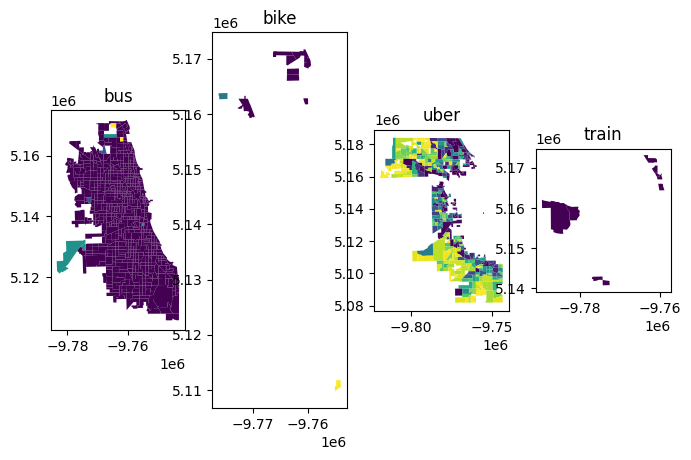

In [25]:
import matplotlib.pyplot as plt
plot_data = tract_missing.groupby(['id','transit'])['missing'].mean().reset_index()
plot_data = plot_data.merge(tracts[['geoid10','geometry']],left_on='id',right_on='geoid10')
plot_data = gpd.GeoDataFrame(plot_data, geometry='geometry').to_crs(WEB_CRS)
fig, axs = plt.subplots(1, plot_data.transit.nunique(), figsize=(8,8))
for t, ax in zip(plot_data.transit.unique(), axs):
    fig = plot_data[plot_data.transit==t].plot('missing', ax=ax)
    fig.set_title(t)

TODO! XXX!

Add assertions here about data completeness, like:

- do we have a full time panel for every unit?
- do we have the expected number of stations, lines, tracts
- do we have the expected number of transits per tract
- are our datatypes valid? are binary variables actually binary (i actually made this mistake)